# Python routine for analyzing calcium oscillations from Hamamatsu data

## Packages

In [1]:
import numpy as np
import pandas as pd
import scipy
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from tqdm import tqdm
import time

## Datafile path specification (main input command)

In [2]:
""" Specify path to the TXT file generated by the Hamamatsu acquisition software"""

filepath = r"C:\Users\fernadi1\OneDrive - Idorsia\Desktop\test hamamatsu\RAW\test.txt"

## Importing metadata

In [3]:
metadata = pd.read_csv(filepath, delimiter='\t', nrows = 6, header = None, index_col= 1)
metadata = metadata.drop(columns=[0])
metadata = metadata[2].to_dict()
original_data_file = metadata['Data File Name :']
adquisition_date = pd.to_datetime(metadata['Date :'])
adquisition_time = pd.to_timedelta(metadata['Time :'])
marker = pd.to_timedelta(metadata['Marker1 :'])



## Importing raw data

In [4]:
rawdata = pd.read_csv(filepath, delimiter='\t', skiprows = [0,1,2,3,4,5,6,8,9,10])

# selecting raw data
rawdata.rename(columns={'No.': 'Time[ms]'}, inplace=True)
rawdata = rawdata.drop(['Unnamed: 0'], axis=1)
rawdata['Time[min]'] =rawdata['Time[ms]'] / 1000 * (1 / 60)


#Transforming time data into pd.to_timedelta object
rawdata['Time[ms]'] = pd.to_timedelta(rawdata['Time[ms]'], unit = 'ms')
rawdata['Time[min]'] = pd.to_timedelta(rawdata['Time[min]'], unit = 'm')

#Transforming time data into integers
rawdata['Time[min]_int'] = rawdata['Time[min]'] / pd.Timedelta(minutes=1)
markerint = marker / pd.Timedelta(minutes=1)

In [5]:
rawdata


,Time[ms],A1,A2,A3,A4,A5,A6,A7,A8,A9,...,H5,H6,H7,H8,H9,H10,H11,H12,Time[min],Time[min]_int
0,0 days 00:00:00,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0 days 00:00:00,0.000000
1,0 days 00:00:00.201000,1.000624,1.006303,1.006428,0.998529,1.005379,1.011228,1.010765,0.996269,1.001668,...,1.001143,1.009845,1.007060,1.004285,1.003805,1.005601,1.001700,1.003155,0 days 00:00:00.201000,0.003350
2,0 days 00:00:00.402000,0.998857,0.999200,1.004436,0.995785,0.996269,0.999589,1.007554,0.991027,0.994415,...,1.001307,1.002311,1.004687,0.999899,1.004861,1.006995,1.001867,1.000428,0 days 00:00:00.402000,0.006700
3,0 days 00:00:00.602000,0.990077,0.990424,0.992946,0.990446,0.999342,0.991323,1.000352,0.987218,0.991165,...,1.000000,0.999635,1.007296,0.996932,1.002452,1.001162,0.996056,0.996278,0 days 00:00:00.601999980,0.010033
4,0 days 00:00:00.803000,0.999795,0.992069,0.989746,0.993045,0.995469,0.987513,0.997851,0.989465,0.990263,...,0.990122,0.994777,1.003946,0.995743,0.993081,0.997495,0.991568,0.997410,0 days 00:00:00.802999980,0.013383
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,0 days 00:10:01.333000,0.963465,0.967206,0.869921,0.893083,0.971174,1.069814,0.977755,1.002034,0.969656,...,1.196144,1.215131,0.979233,1.148925,0.969574,1.134400,0.841746,0.855934,0 days 00:10:01.333000020,10.022217
2996,0 days 00:10:01.534000,0.954997,0.963807,0.877533,0.888105,0.972209,1.066647,0.979217,1.003712,0.980936,...,1.201053,1.217869,0.974427,1.142035,0.969263,1.131319,0.837259,0.853019,0 days 00:10:01.534000020,10.025567
2997,0 days 00:10:01.735000,0.960038,0.966193,0.873942,0.894258,0.979382,1.065977,0.975777,1.010195,0.975765,...,1.191551,1.218786,0.978958,1.148071,0.980542,1.136761,0.833311,0.857928,0 days 00:10:01.735000020,10.028917
2998,0 days 00:10:01.936000,0.963209,0.967180,0.867023,0.886437,0.971249,1.071014,0.984958,1.008288,0.975637,...,1.198823,1.213536,0.986515,1.143204,0.970435,1.128654,0.835975,0.852314,0 days 00:10:01.936000020,10.032267


## Plotting all wells

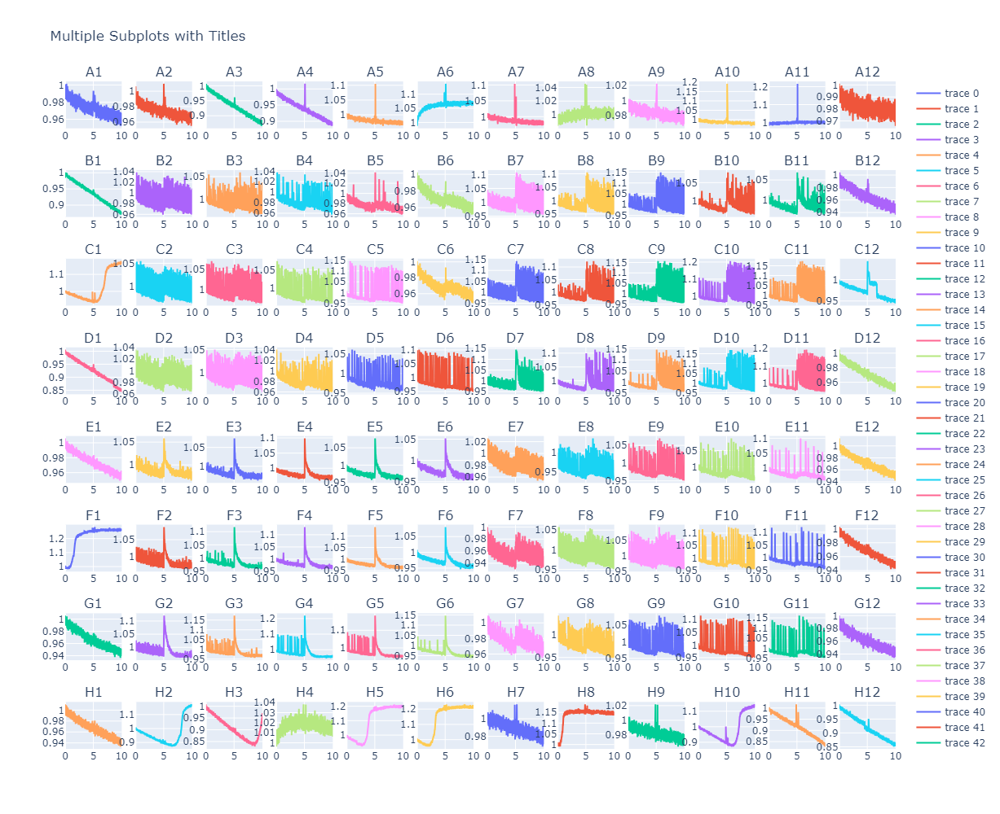

In [6]:
#subplots with plotly

from plotly.subplots import make_subplots

wells = list(rawdata)[1:-2]
well = 0

fig = make_subplots(
    rows=8, cols=12,
    subplot_titles=(wells))

i,j = 1,1

for well in wells:
    fig.add_trace(go.Scatter(x = rawdata['Time[min]_int'], y=rawdata[well]), row=j, col=i)
        
    i += 1
    if i == 13:
        i = 1
        j += 1


fig.update_layout(height=1000, width=1500,
                  title_text="Multiple Subplots with Titles")

fig.show()        

Plotting your data. This might take up to 30 seconds...: 100%|████████████████████████| 96/96 [00:00<00:00, 666.52it/s]


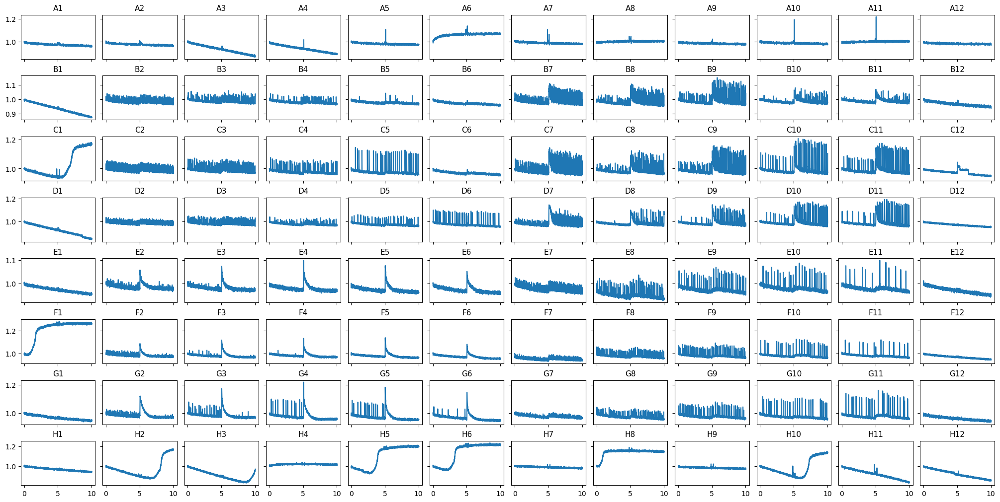

In [7]:
plotrows = 8
plotcolumns = 12
total_graphs = plotrows * plotcolumns

fig, ax = plt.subplots(plotrows, plotcolumns, sharex='col', sharey='row', figsize=[20, 10], layout='constrained')

wells = list(rawdata)[1:-2]
well = 0

i,j = 0,0

for well in tqdm(wells, desc ="Plotting your data. This might take up to 30 seconds..."):
    ax[j,i].plot(rawdata['Time[min]_int'], rawdata[well])
    ax[j,i].set_title(well, fontsize=11)
    
    i += 1
    if i == 12:
        i = 0
        j += 1

        
plt.show()
        
        
# look a way to show the data with seaborn
# g = sns.FacetGrid(penguins, col="species",  row="sex")
# g.map(sns.scatterplot, 'bill_length_mm', 'flipper_length_mm')

## Setting the code for peak analysis

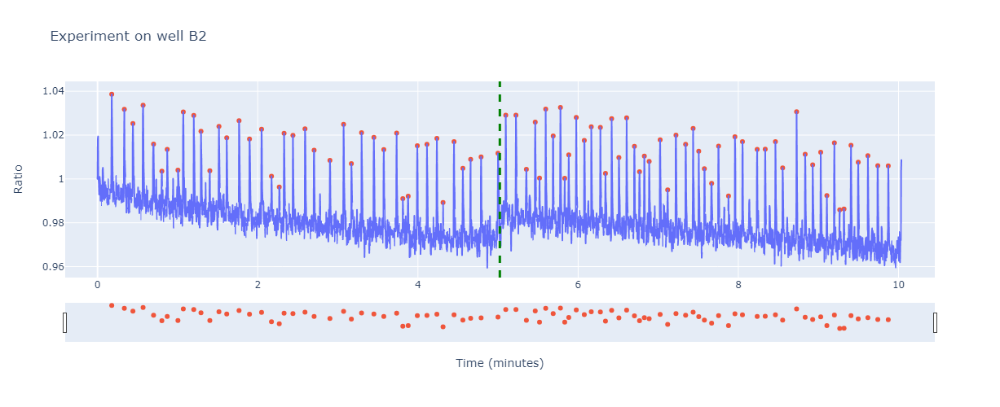

In [12]:
#select well to analyze

analysiswell = 'B2'
x=rawdata['Time[min]_int']
y=rawdata[analysiswell]

fig2 = px.line(rawdata, x, y, height=500,
               labels={"Time[min]_int" : "Time (minutes)", analysiswell:"Ratio"}, title= ('Experiment on well '+analysiswell))                
fig2.update_xaxes(rangeslider_visible=True)
fig2.add_vline(x=markerint, line_width=3, line_dash="dash", line_color="green")

from scipy.signal import find_peaks

X = np.array(x.to_numpy())
Y = np.array(y.to_numpy())

peaks, properties = find_peaks(Y, prominence = 0.02)

fig2.add_trace(go.Scatter(mode='markers',x = x[peaks], y = Y[peaks], showlegend=False))


fig2.show()

    
    

## Analyzing the trace for calcium oscillations

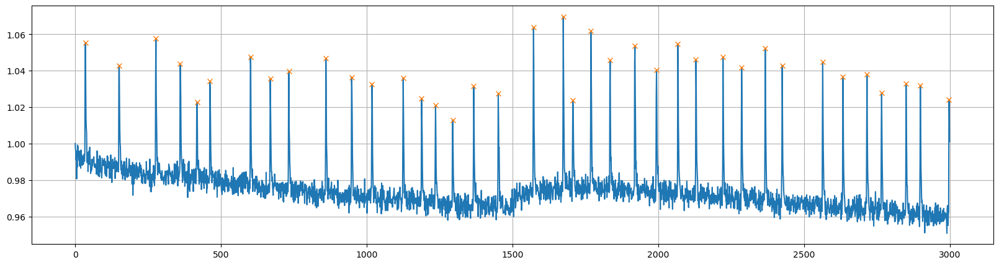

In [16]:
from scipy.signal import find_peaks

X = np.array(x.to_numpy())
Y = np.array(y.to_numpy())


peaks, properties = find_peaks(Y, prominence = 0.02)

fig3 = plt.figure(figsize=(20,5))
plt.plot(Y)
plt.grid()
plt.plot(peaks, Y[peaks], "x")
plt.show()

## Fourier transformation

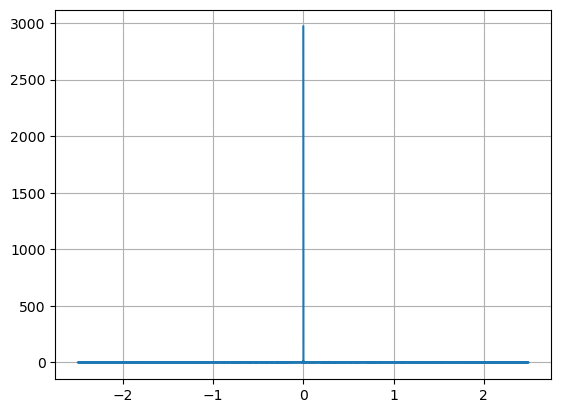

In [ ]:
from scipy.fft import fft, fftfreq
import numpy as np
# Number of sample points
N = 3000

# sample spacing
T = 0.2

Yf = fft(Y)
Xf = fftfreq(N, T)
plt.plot(Xf, np.abs(Yf))
plt.grid()
plt.show()

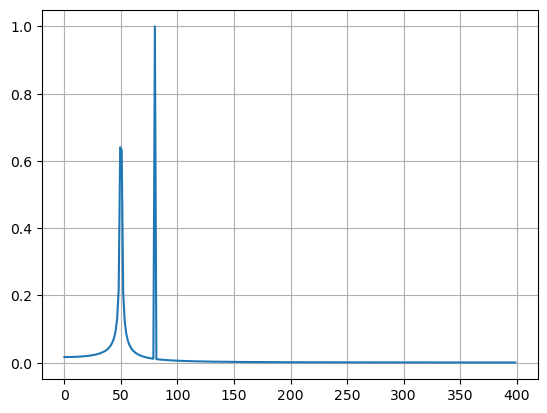

In [11]:
from scipy.fft import fft, fftfreq
import numpy as np
# Number of sample points
N = 600
# sample spacing
T = 1.0 / 800.0
x = np.linspace(0.0, N*T, N, endpoint=False)
y = np.sin(50.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x)
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
import matplotlib.pyplot as plt
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()